In [1]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
import os
import pandas as pd
import random
import torch
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
from PIL import Image, ImageDraw
import cv2
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from IPython.display import display, Image as IPImage
import plotly.express as px

import torchvision.models as models
import torch.nn as nn
import torch.optim as optim



# Import YOLOv5
os.chdir('/Users/vinithshetty/Documents/Project for ML/Case Study 2/yolov5')
from utils.general import check_img_size, non_max_suppression, scale_boxes
from utils.plots import plot_one_box
from utils.datasets import letterbox


In [2]:
# Define the relative paths to the folders
train_folder = "./images/train/"
val_folder = "./images/val/"
test_folder = "./images/test/"
train_labels_folder = './labels/train/'
val_labels_folder = "./labels/val/"
test_labels_folder = "./labels/test/"

In [3]:
# List of valid image extensions
valid_extensions = ('.png', '.jpg', '.jpeg')

In [4]:
# Get list of image files in the train folder
image_files = [
    f for f in os.listdir(train_folder)
    if os.path.isfile(os.path.join(train_folder, f)) and f.lower().endswith(valid_extensions)
]

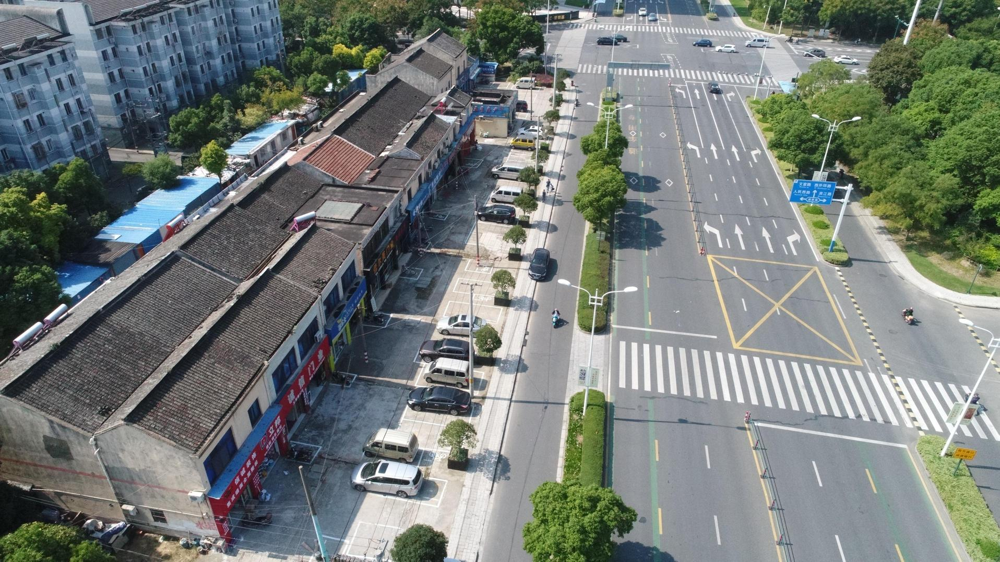

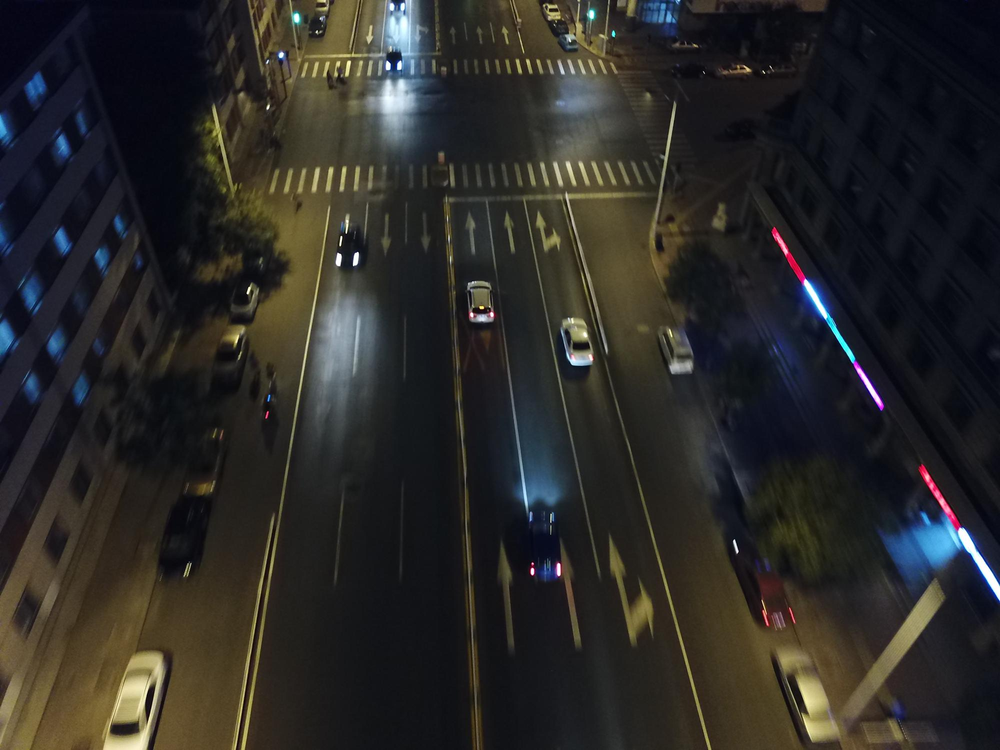

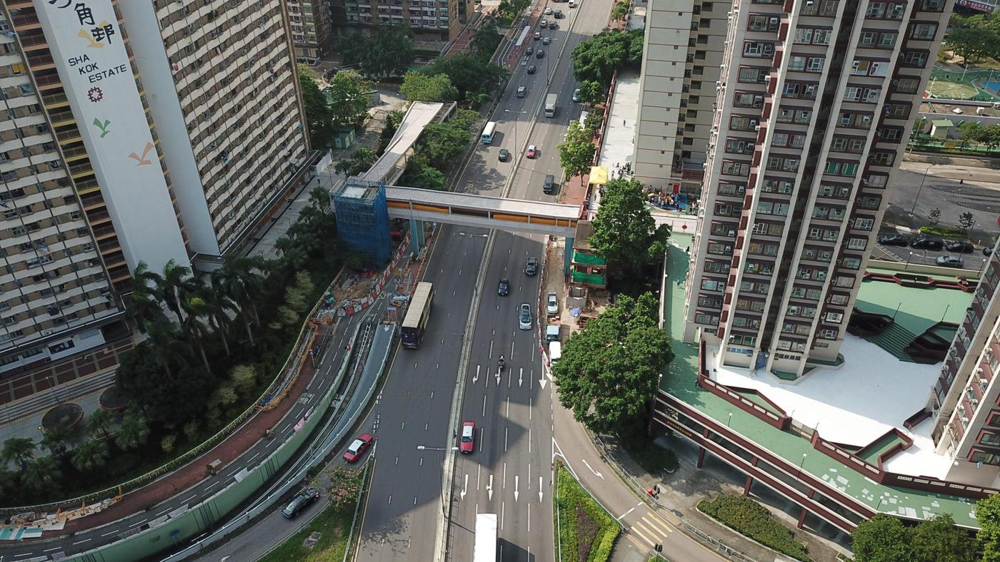

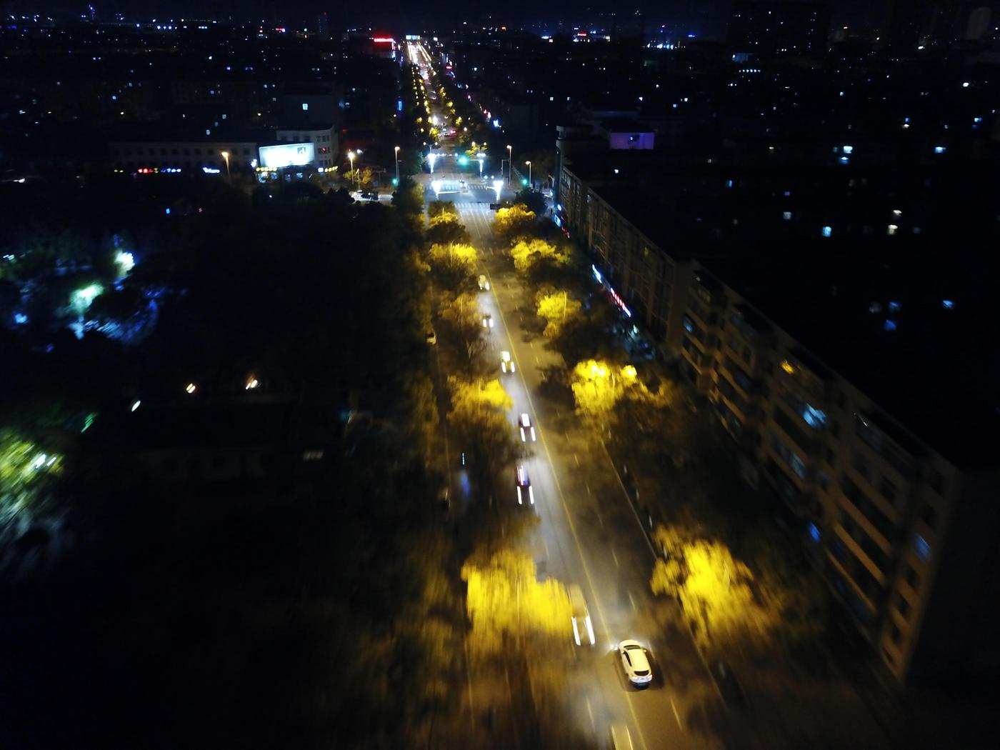

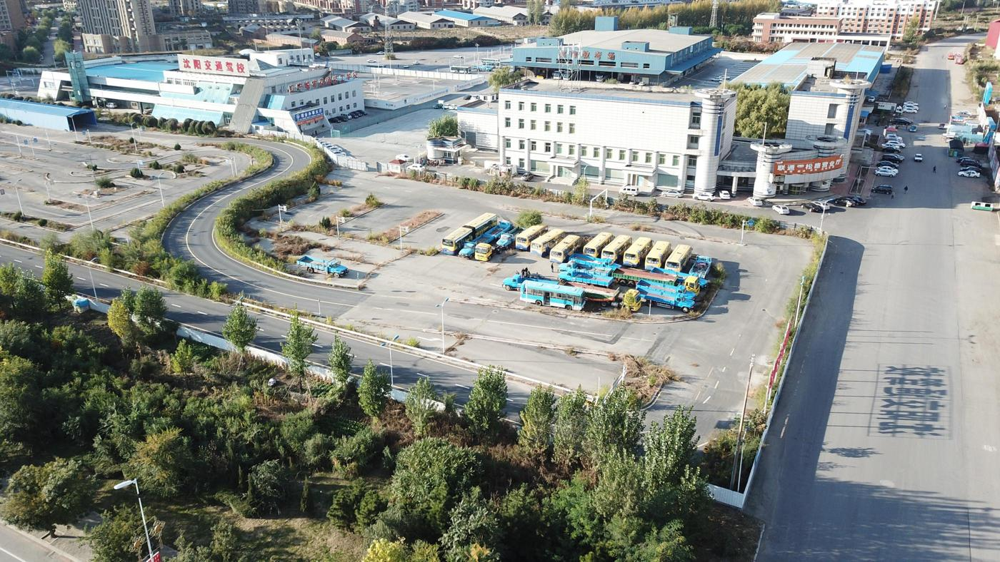

In [5]:
# Number of random images to select
num_random_images = 5

# Select random images
random_images = random.sample(image_files, num_random_images)

# Display the random images
for img_file in random_images:
    img_path = os.path.join(train_folder, img_file)
    img = Image.open(img_path)
    display(img)

In [6]:
# Function to read the labels from a directory
def read_labels_from_dir(label_dir):
    labels = {}
    for file_name in os.listdir(label_dir):
        file_path = os.path.join(label_dir, file_name)
        with open(file_path, 'r') as file:
            for line in file:
                parts = line.strip().split()
                if len(parts) == 2:
                    image_name, label = parts
                    labels[image_name] = label
    return labels

train_labels_dict = read_labels_from_dir(train_labels_folder)
val_labels_dict = read_labels_from_dir(val_labels_folder)
test_labels_dict = read_labels_from_dir(test_labels_folder)

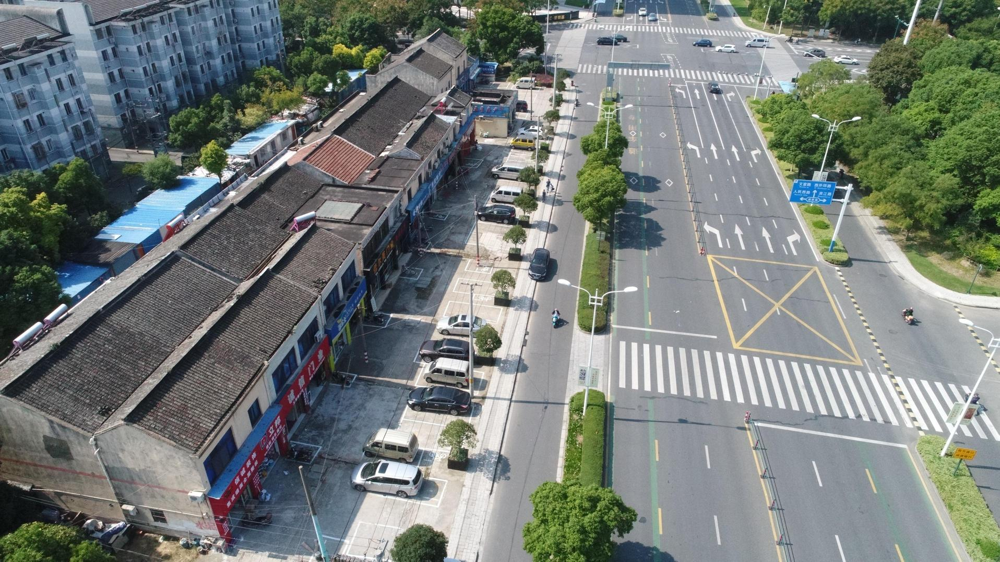

9999977_00000_d_0000014.jpg
Label: Unknown



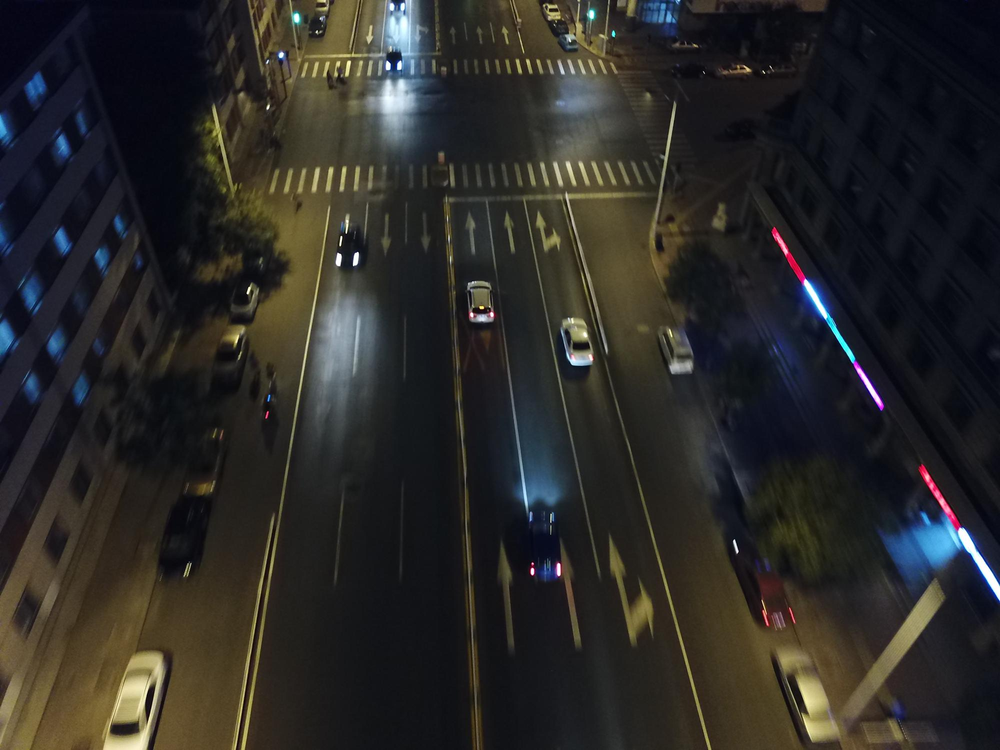

9999998_00145_d_0000121.jpg
Label: Unknown



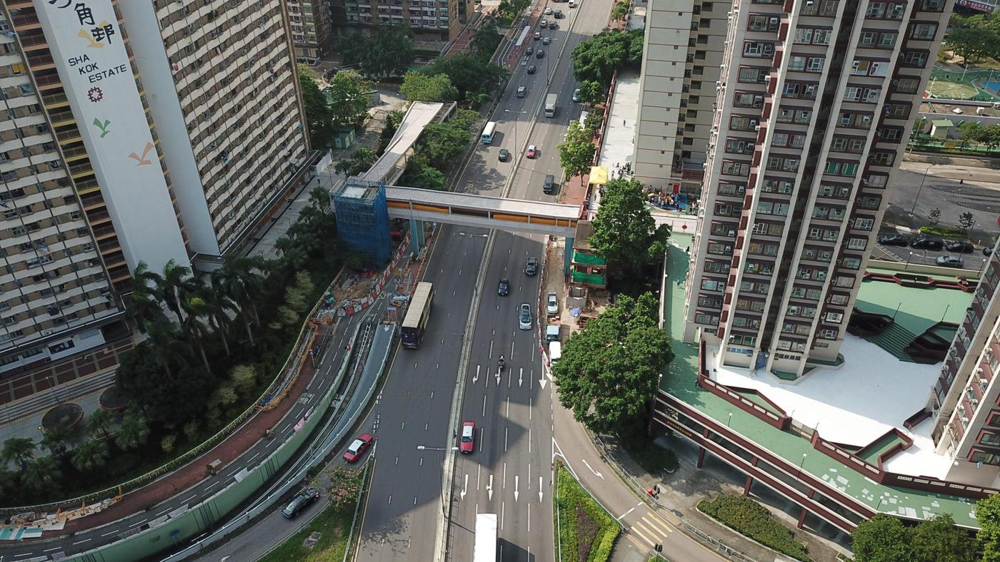

9999956_00000_d_0000019.jpg
Label: Unknown



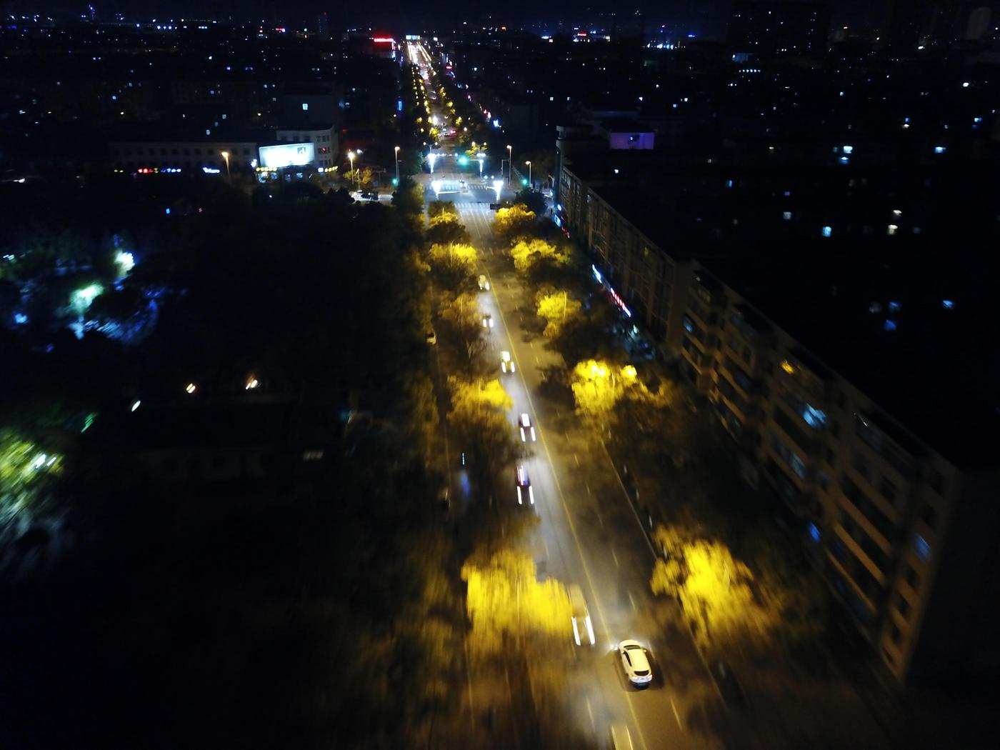

9999945_00000_d_0000001.jpg
Label: Unknown



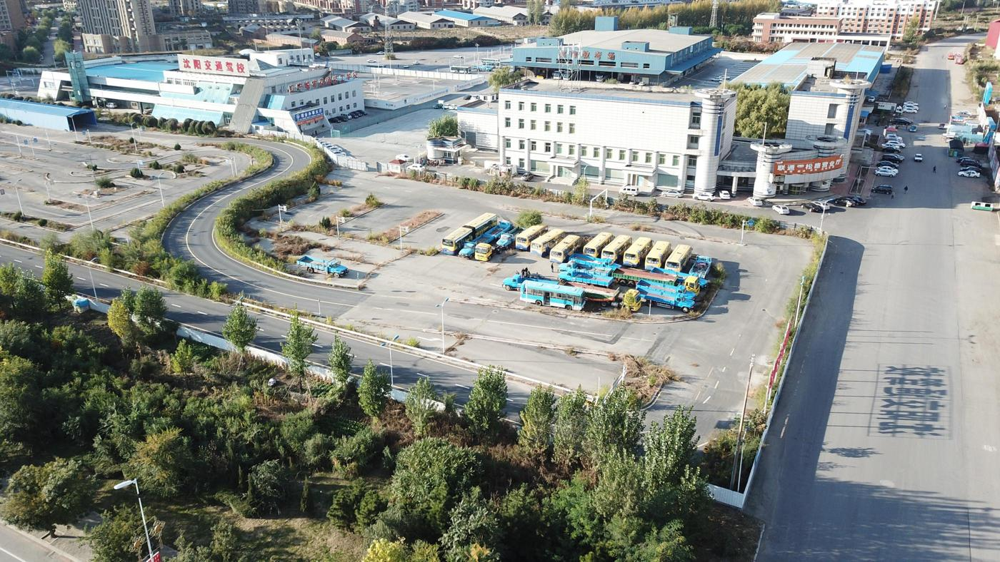

9999965_00000_d_0000009.jpg
Label: Unknown



In [7]:
# Function to display images with labels
def display_images_with_labels(image_folder, image_files, labels_dict):
    for img_file in image_files:
        img_path = os.path.join(image_folder, img_file)
        img = Image.open(img_path)
        label = labels_dict.get(img_file, 'Unknown')
        display(img)
        print(f"{img_file}\nLabel: {label}\n")

# Display the random images with their labels
display_images_with_labels(train_folder, random_images, train_labels_dict)

In [8]:
# Define the categories
categories = {
    0: 'pedestrian',
    1: 'people',
    2: 'bicycle',
    3: 'car',
    4: 'van',
    5: 'truck',
    6: 'tricycle',
    7: 'awning-tricycle',
    8: 'bus',
    9: 'motor'
}

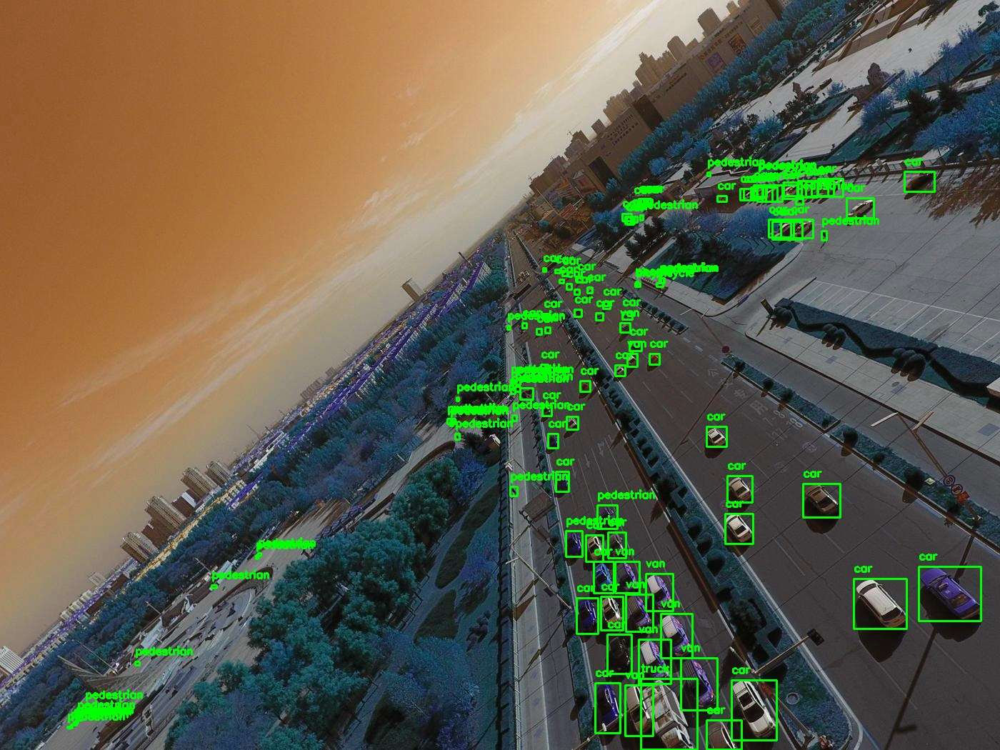

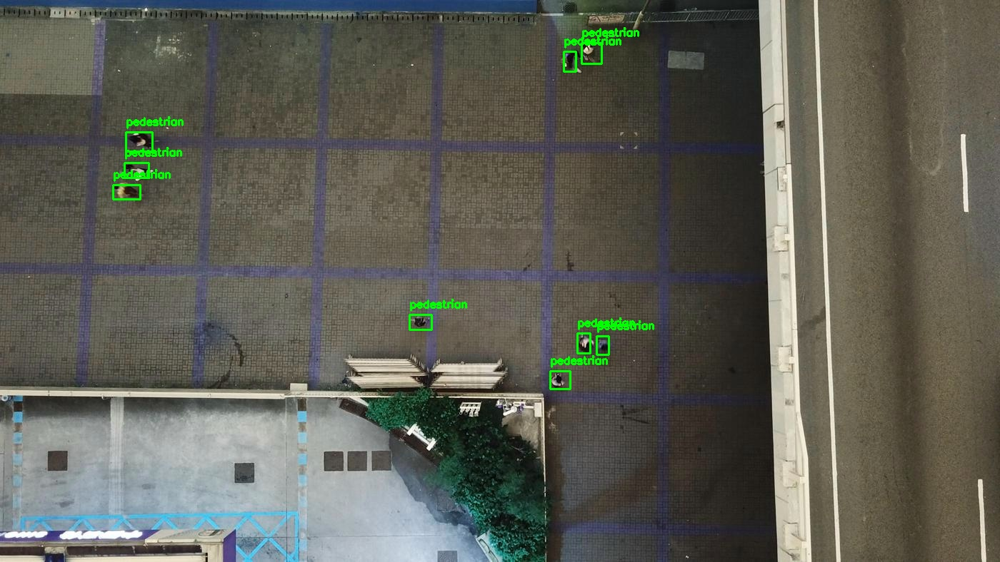

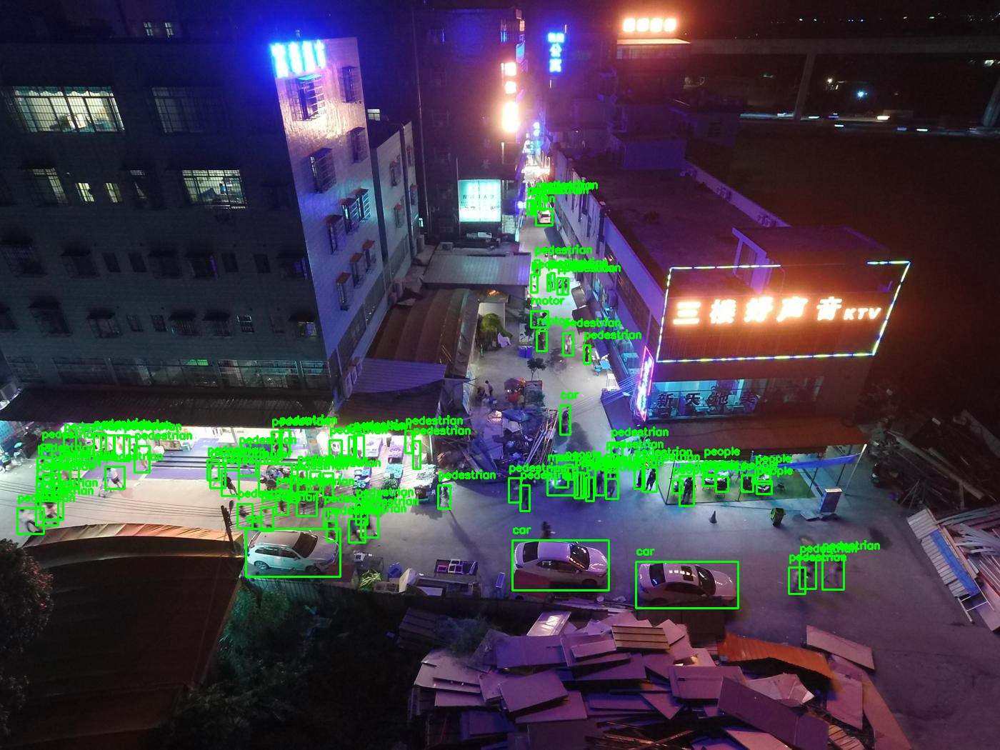

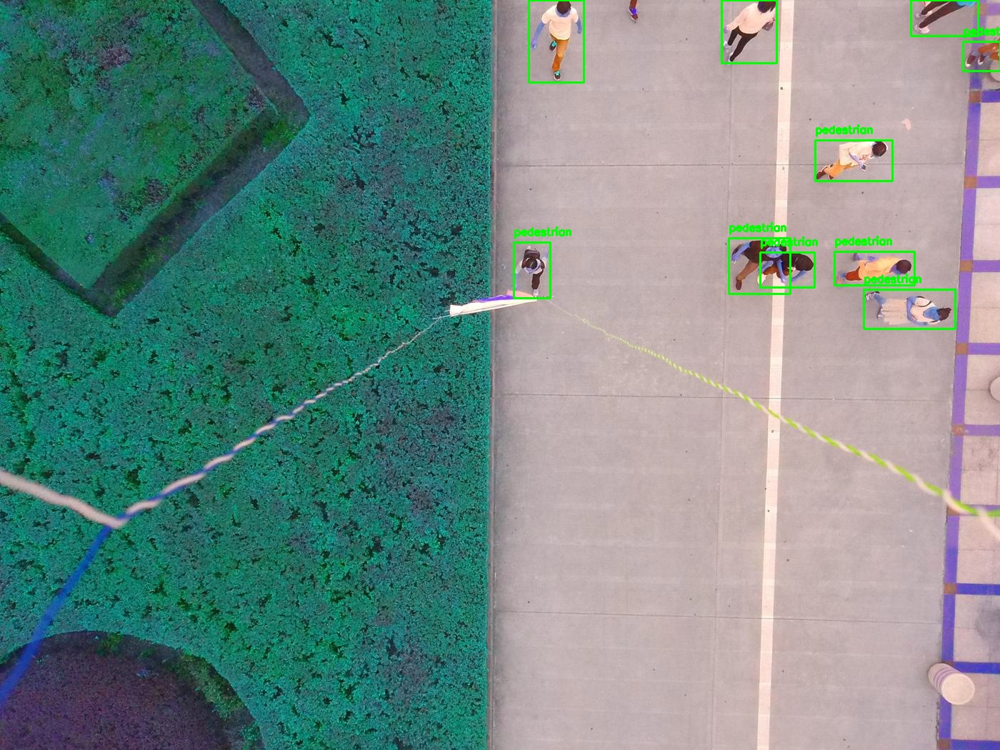

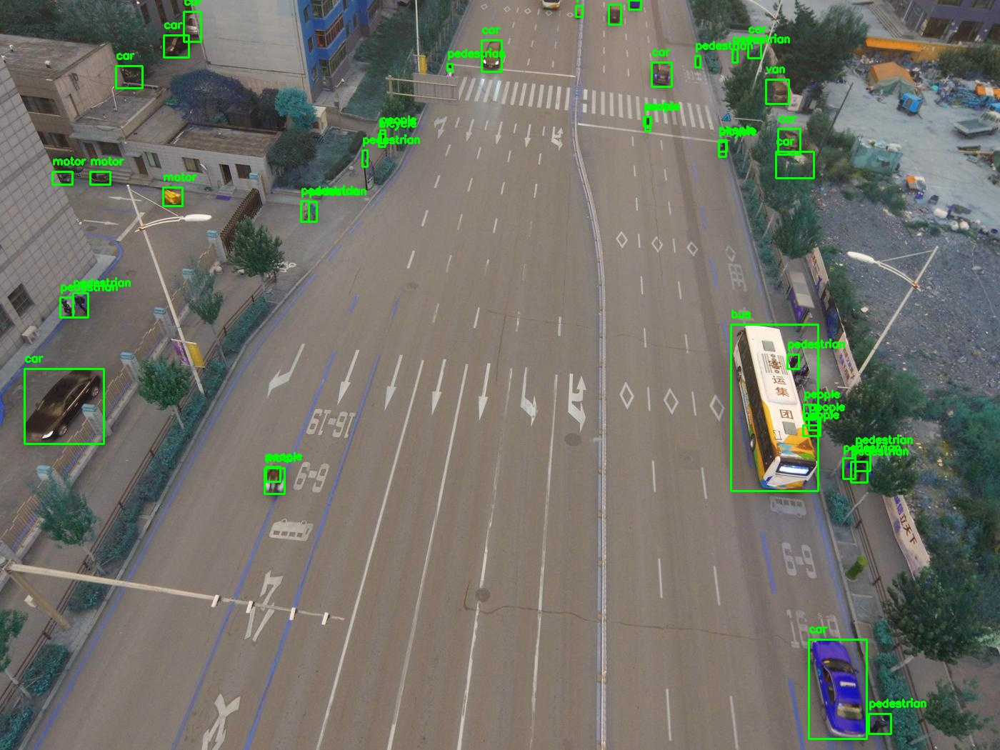

In [9]:
# Shuffle the image files to ensure randomness
random.shuffle(image_files)

# Select random images
random_images = image_files[:num_random_images]


# Function to draw bounding boxes and annotations on an image
def draw_boxes(img, annotation_file):
    image_height, image_width, _ = img.shape
    with open(annotation_file, 'r') as f:
        lines = f.readlines()
    for line in lines:
        values = list(map(float, line.strip().split(' ')))
        cls, x, y, w, h = values
        x = int((x - w / 2) * image_width)
        y = int((y - h / 2) * image_height)
        w = int(w * image_width)
        h = int(h * image_height)
        cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)
        category = categories.get(int(cls), 'Unknown')
        cv2.putText(img, category, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
    return img

# Display the random images with bounding boxes
for img_file in random_images:
    img_path = os.path.join(train_folder, img_file)
    img = cv2.imread(img_path)
    if img is not None:
        annotation_file = os.path.join(train_labels_folder, os.path.splitext(img_file)[0] + '.txt')
        if os.path.exists(annotation_file):
            img = draw_boxes(img, annotation_file)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        output_path = os.path.join("/tmp", f"output_{img_file}")
        cv2.imwrite(output_path, img_rgb)
        display(IPImage(filename=output_path))
    else:
        print(f"Image {img_file} not found")

In [10]:
class CustomDataset(Dataset):
    def __init__(self, image_folder, labels_folder, transform=None):
        self.image_folder = image_folder
        self.labels_folder = labels_folder
        self.image_files = [
            f for f in os.listdir(image_folder)
            if os.path.isfile(os.path.join(image_folder, f)) and f.lower().endswith(valid_extensions)
        ]
        self.labels_dict = self.read_labels_from_dir(labels_folder)
        self.transform = transform

    def read_labels_from_dir(self, label_dir):
        labels = {}
        for file_name in os.listdir(label_dir):
            file_path = os.path.join(label_dir, file_name)
            with open(file_path, 'r') as file:
                for line in file:
                    parts = line.strip().split()
                    if len(parts) == 2:
                        image_name, label = parts
                        labels[image_name] = label
        return labels

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        img_name = self.image_files[idx]
        img_path = os.path.join(self.image_folder, img_name)
        image = Image.open(img_path).convert("RGB")
        
        if self.transform:
            image = self.transform(image)
        
        label = self.labels_dict.get(img_name, 'Unknown')
        return image, label

    def draw_boxes(self, img, annotation_file):
        image_height, image_width, _ = img.shape
        with open(annotation_file, 'r') as f:
            lines = f.readlines()
        for line in lines:
            values = list(map(float, line.strip().split(' ')))
            cls, x, y, w, h = values
            x = int((x - w / 2) * image_width)
            y = int((y - h / 2) * image_height)
            w = int(w * image_width)
            h = int(h * image_height)
            cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)
            category = categories.get(int(cls), 'Unknown')
            cv2.putText(img, category, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
        return img

    def display_random_images(self, num_images=5):
        random_images = random.sample(self.image_files, num_images)
        for img_file in random_images:
            img_path = os.path.join(self.image_folder, img_file)
            img = cv2.imread(img_path)
            if img is not None:
                annotation_file = os.path.join(self.labels_folder, os.path.splitext(img_file)[0] + '.txt')
                if os.path.exists(annotation_file):
                    img = self.draw_boxes(img, annotation_file)
                img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                output_path = os.path.join("/tmp", f"output_{img_file}")
                cv2.imwrite(output_path, img_rgb)
                display(IPImage(filename=output_path))
            else:
                print(f"Image {img_file} not found")

In [11]:
# Example usage
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor()
])

train_dataset = CustomDataset(train_folder, train_labels_folder, transform=transform)
val_dataset = CustomDataset(val_folder, val_labels_folder, transform=transform)
test_dataset = CustomDataset(test_folder, test_labels_folder, transform=transform)

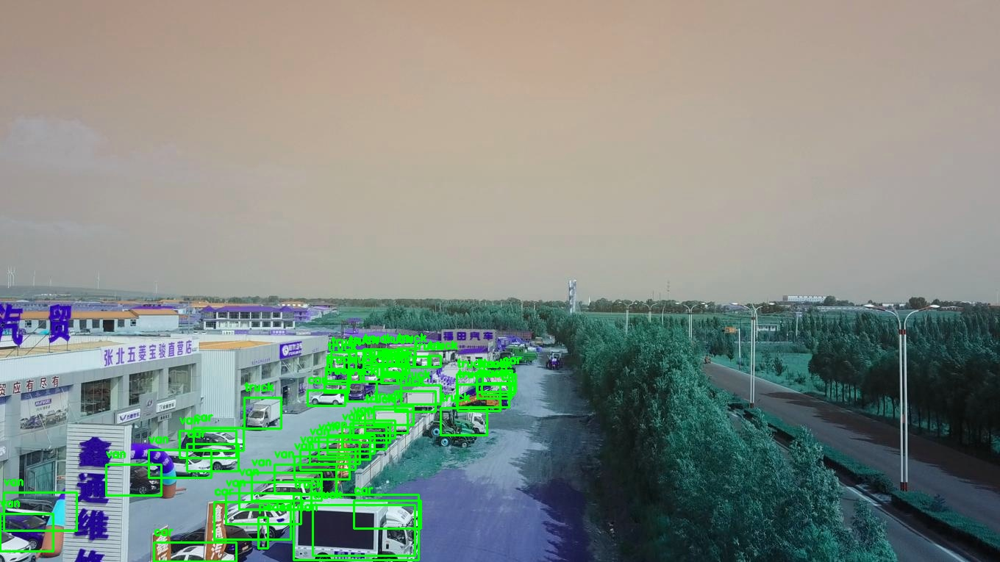

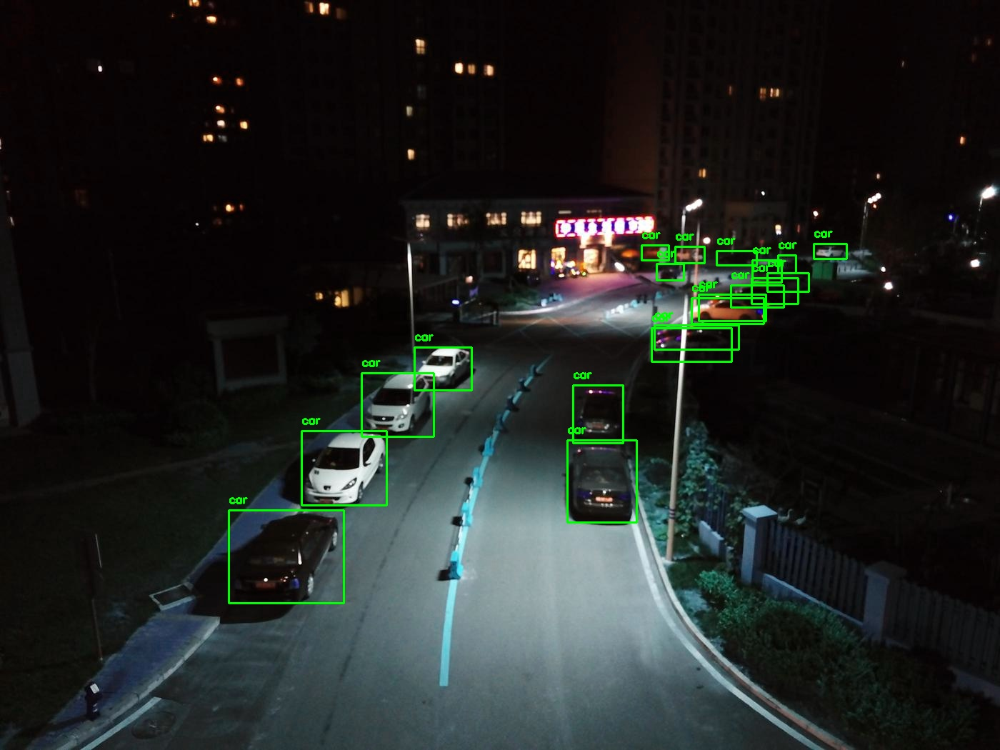

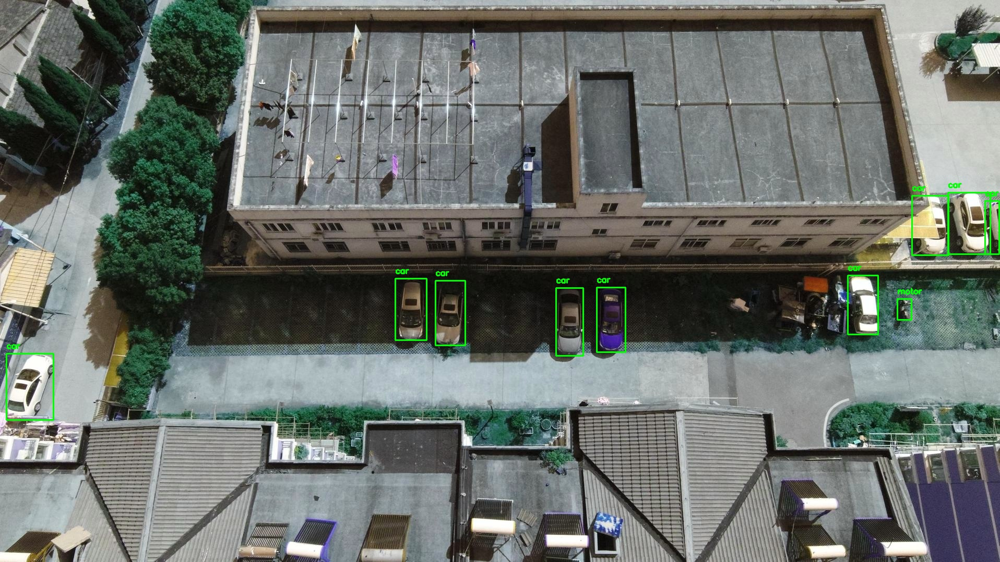

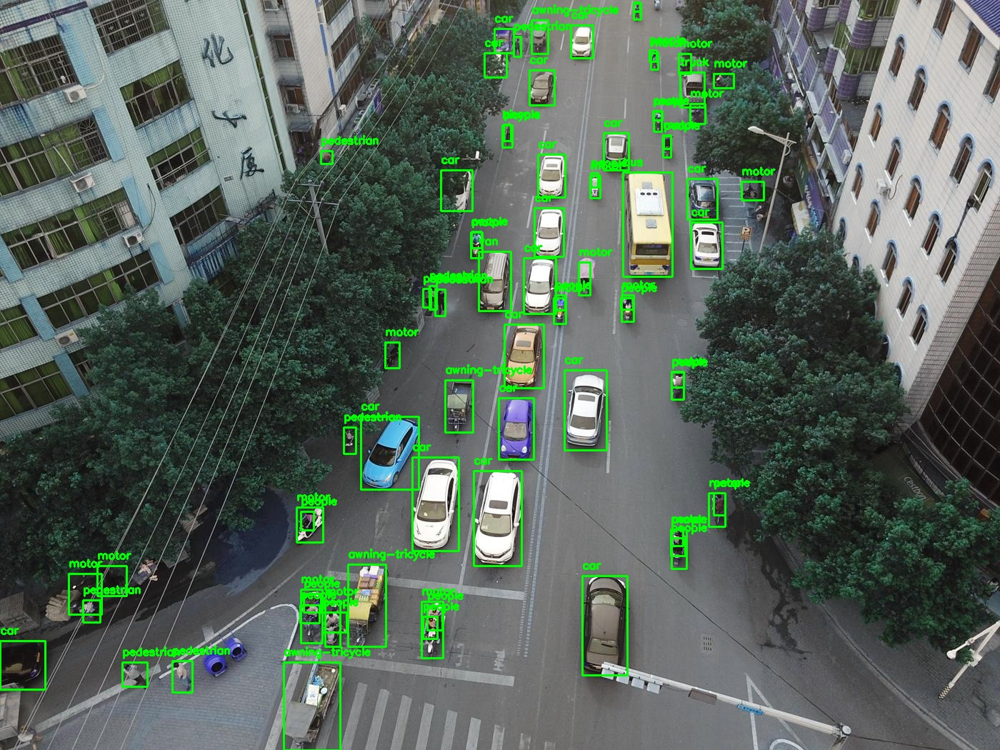

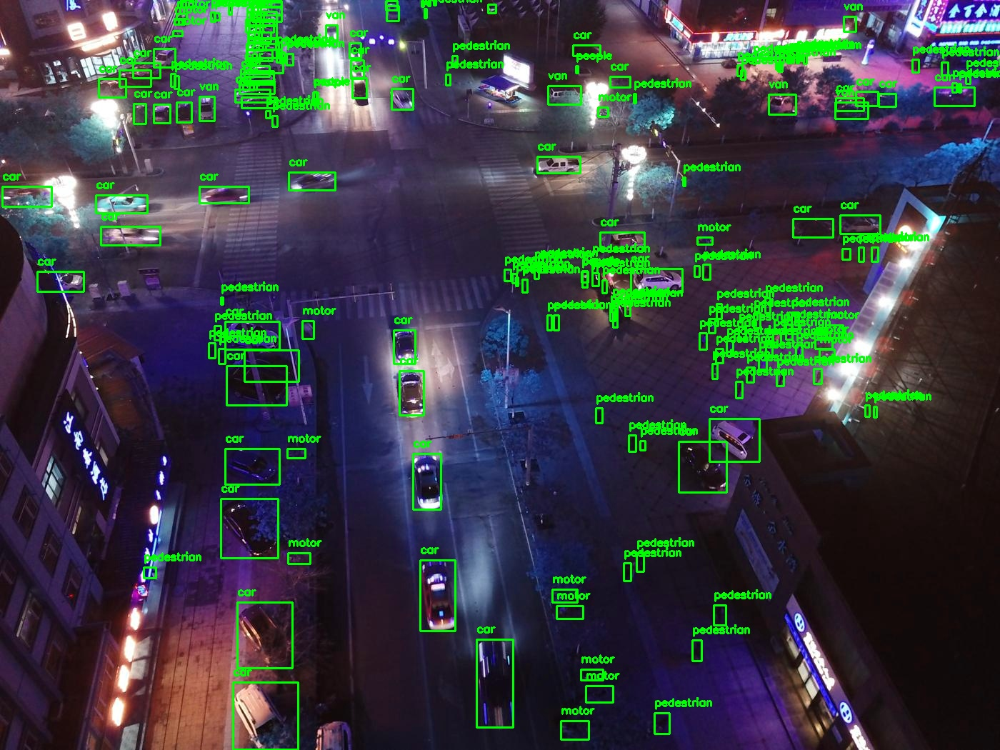

In [12]:
# Display random images from the training dataset
train_dataset.display_random_images(num_images=5)

# Creating a DataLoader
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

In [13]:
# Function to read labels from a file
def read_label(file_path):
    with open(file_path, 'r') as file:
        return file.read().strip()


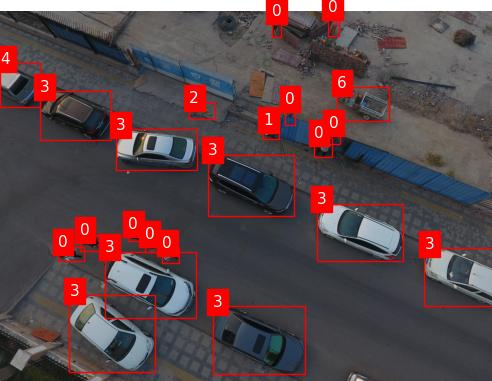

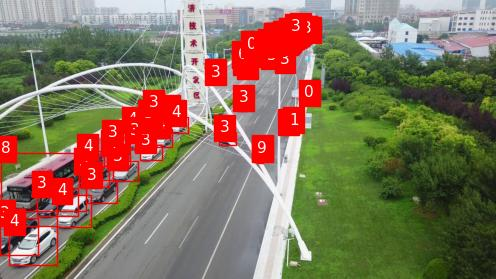

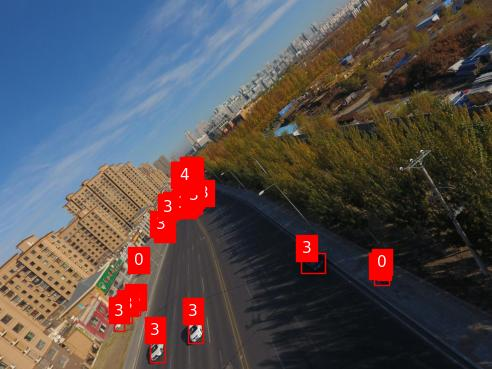

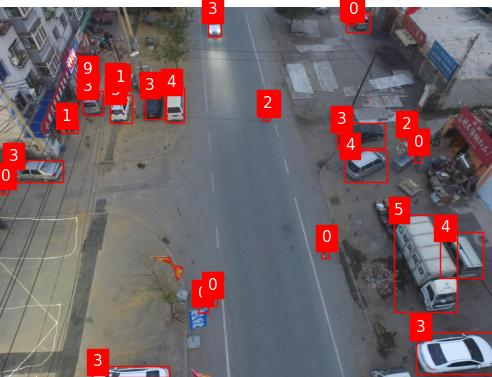

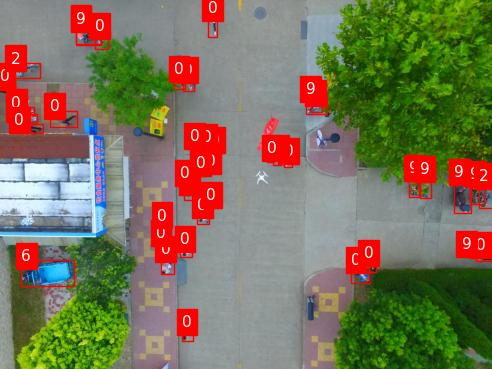

In [14]:
# Function to plot image with label
def plot_image_with_label(img_path, label, output_path):
    image = Image.open(img_path)
    fig, ax = plt.subplots(1)
    ax.imshow(image)
    
    # Assuming labels are in YOLO format: class x_center y_center width height
    for line in label.split('\n'):
        parts = line.split()
        if len(parts) == 5:
            cls, x_center, y_center, width, height = map(float, parts)
            x_center *= image.width
            y_center *= image.height
            width *= image.width
            height *= image.height
            x_min = x_center - width / 2
            y_min = y_center - height / 2

            rect = patches.Rectangle((x_min, y_min), width, height, linewidth=1, edgecolor='r', facecolor='none')
            ax.add_patch(rect)
            plt.text(x_min, y_min, str(int(cls)), color='white', backgroundcolor='red')

    plt.axis('off')
    plt.savefig(output_path, bbox_inches='tight', pad_inches=0)
    plt.close(fig)

# Shuffle the image files to ensure randomness
random.shuffle(image_files)

# Number of random images to select
num_random_images = 5

# Select random images
random_images = image_files[:num_random_images]

# Visualize random images with labels
for img_file in random_images:
    img_path = os.path.join(train_folder, img_file)
    label_file = os.path.splitext(img_file)[0] + '.txt'
    label_path = os.path.join(train_labels_folder, label_file)
    output_path = os.path.join("/tmp", f"output_{img_file}")
    if os.path.exists(label_path):
        label = read_label(label_path)
        plot_image_with_label(img_path, label, output_path)
        display(IPImage(filename=output_path))
    else:
        print(f"Label file not found for {img_file}")

In [15]:
# Function to parse label data from YOLO format
def parse_label(label):
    parsed_labels = []
    for line in label.split('\n'):
        parts = line.split()
        if len(parts) == 5:
            cls, x_center, y_center, width, height = map(float, parts)
            parsed_labels.append((int(cls), x_center, y_center, width, height))
    return parsed_labels


# Collect all labels
all_labels = []
for img_file in image_files:
    label_file = os.path.splitext(img_file)[0] + '.txt'
    label_path = os.path.join(train_labels_folder, label_file)
    if os.path.exists(label_path):
        label = read_label(label_path)
        all_labels.extend(parse_label(label))

# Create DataFrame
df_labels = pd.DataFrame(all_labels, columns=['class', 'x_center', 'y_center', 'width', 'height'])
print(df_labels.head())

# Example analysis: Class distribution
class_counts = df_labels['class'].value_counts()
print(class_counts)

# Interactive class distribution using Plotly
fig = px.bar(class_counts, x=class_counts.index, y=class_counts.values, labels={'index':'Class', 'y':'Frequency'}, title='Class Distribution')
fig.show()

   class  x_center  y_center   width    height
0      3   0.22700  0.871333  0.1730  0.206667
1      3   0.30475  0.738667  0.1855  0.178667
2      3   0.52450  0.889667  0.1870  0.183333
3      0   0.14350  0.656000  0.0520  0.038667
4      0   0.18625  0.625333  0.0475  0.042667
class
3    44282
0    23842
9     8766
1     8644
4     7456
5     3781
2     3290
8     1725
6     1465
7     1024
Name: count, dtype: int64


In [16]:
import os

# Function to train the YOLOv5 model with optimized anchor boxes
def train_yolov5(data_path, weights_path, img_size=640, batch_size=8, epochs=50, hyp_path='hyp.custom.yaml', save_model_path='best_model.pt'):
    # Change to the yolov5 directory
    os.chdir('/Users/vinithshetty/Documents/Project for ML/Case Study 2/yolov5')
    
    # Run the training script with anchor optimization
    os.system(f'python train.py --img {img_size} --batch {batch_size} --epochs {epochs} --data {data_path} --weights {weights_path} --hyp {hyp_path} --noautoanchor')
    
    # Move the best model to the desired location
    best_model_path = os.path.join('/Users/vinithshetty/Documents/Project for ML/Case Study 2/yolov5/runs/train/exp', 'weights/best.pt')
    if os.path.exists(best_model_path):
        os.rename(best_model_path, save_model_path)
    else:
        print("Model not found. Please check the training process.")

# Example usage: Set the number of epochs to 20 for improved training
train_yolov5('custom_dataset.yaml', 'yolov5s.pt', epochs=50, hyp_path='hyp.custom.yaml')


train: weights=yolov5s.pt, cfg=, data=custom_dataset.yaml, hyp=hyp.custom.yaml, epochs=50, batch_size=8, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=True, noplots=False, evolve=None, evolve_population=data/hyps, resume_evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest, ndjson_console=False, ndjson_file=False
From https://github.com/ultralytics/yolov5
 * [new branch]        refactor-20240716233656 -> origin/refactor-20240716233656
github: ⚠️ YOLOv5 is out of date by 2 commits. Use 'git pull' or 'git clone https://github.com/ultralytics/yolov5' to update.
fatal: cannot change to '/Users/vinithshetty/Documents/Project': No such file or d

                 Class     Images  Instances          P          R      mAP50   mAP50-95:   9%|▉         | 1/11 [00:04<00:42,  4.21s/it]WARNING ⚠️ NMS time limit 1.300s exceeded
                 Class     Images  Instances          P          R      mAP50   mAP50-95:  18%|█▊        | 2/11 [00:08<00:36,  4.10s/it]WARNING ⚠️ NMS time limit 1.300s exceeded
                 Class     Images  Instances          P          R      mAP50   mAP50-95:  36%|███▋      | 4/11 [00:15<00:27,  3.92s/it]WARNING ⚠️ NMS time limit 1.300s exceeded
                 Class     Images  Instances          P          R      mAP50   mAP50-95:  45%|████▌     | 5/11 [00:19<00:23,  3.89s/it]WARNING ⚠️ NMS time limit 1.300s exceeded
                 Class     Images  Instances          P          R      mAP50   mAP50-95:  64%|██████▎   | 7/11 [00:26<00:14,  3.67s/it]WARNING ⚠️ NMS time limit 1.300s exceeded
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100%|██████████| 11/


      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
      16/49         0G    0.05477     0.1286    0.02316        692        640: 100%|██████████| 243/243 [05:18<00:00,  1.31s/it]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100%|██████████| 11/11 [00:29<00:00,  2.71s/it]
                   all        165      12340      0.419      0.257      0.238      0.122

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
      17/49         0G    0.05475     0.1281    0.02231        651        640: 100%|██████████| 243/243 [05:17<00:00,  1.31s/it]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100%|██████████| 11/11 [00:30<00:00,  2.74s/it]
                   all        165      12340      0.335      0.256      0.239      0.123

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
      18/49         0G    0.05465     0.1289    0.0

      35/49         0G    0.04943     0.1196    0.01836        649        640: 100%|██████████| 243/243 [05:17<00:00,  1.31s/it]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100%|██████████| 11/11 [00:28<00:00,  2.63s/it]
                   all        165      12340      0.359      0.291      0.273      0.146

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
      36/49         0G    0.04968     0.1195    0.01819        439        640: 100%|██████████| 243/243 [05:20<00:00,  1.32s/it]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100%|██████████| 11/11 [00:28<00:00,  2.62s/it]
                   all        165      12340      0.355      0.292      0.272      0.146

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
      37/49         0G    0.04963     0.1197    0.01798        360        640: 100%|██████████| 243/243 [05:18<00:00,  1.31s/it]
 

Model not found. Please check the training process.


In [28]:
import torch

# Assuming 'model' is your YOLOv5 model after training
model_path = 'yolov5new_model.pth'
torch.save(model.state_dict(), model_path)
print(f"Model weights saved to {model_path}")

Model weights saved to yolov5new_model.pth


In [29]:
# Ensure the working directory is set correctly
os.chdir('/Users/vinithshetty/Documents/Project for ML/Case Study 2/yolov5')
print("Current Working Directory:", os.getcwd())

Current Working Directory: /Users/vinithshetty/Documents/Project for ML/Case Study 2/yolov5


In [30]:
# Function to read labels from a file
def read_label(file_path):
    with open(file_path, 'r') as file:
        return file.read().strip()

In [31]:
# Function to draw bounding boxes and annotations on an image
def plot_image_with_label(img_path, label, output_path):
    image = Image.open(img_path)
    fig, ax = plt.subplots(1)
    ax.imshow(image)
    
    # Assuming labels are in YOLO format: class x_center y_center width height
    for line in label.split('\n'):
        parts = line.split()
        if len(parts) == 5:
            cls, x_center, y_center, width, height = map(float, parts)
            x_center *= image.width
            y_center *= image.height
            width *= image.width
            height *= image.height
            x_min = x_center - width / 2
            y_min = y_center - height / 2

            rect = patches.Rectangle((x_min, y_min), width, height, linewidth=1, edgecolor='r', facecolor='none')
            ax.add_patch(rect)
            plt.text(x_min, y_min, str(int(cls)), color='white', backgroundcolor='red')

    plt.axis('off')
    plt.savefig(output_path, bbox_inches='tight', pad_inches=0)
    plt.close(fig)

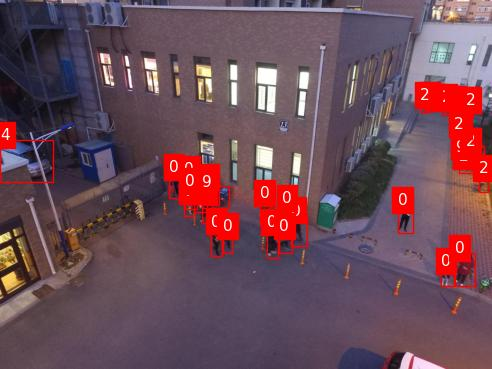

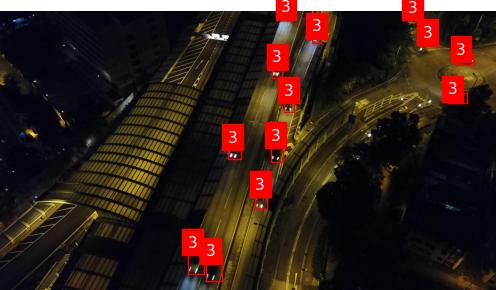

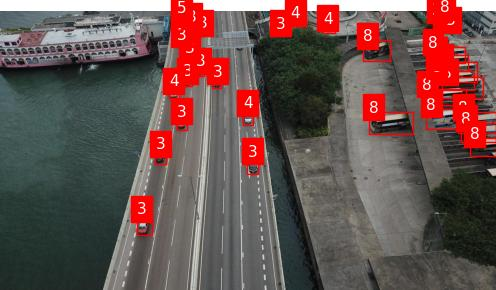

In [32]:
# Visualize random images with labels
random_images = random.sample(os.listdir(train_folder), num_random_images)
for img_file in random_images:
    img_path = os.path.join(train_folder, img_file)
    label_file = os.path.splitext(img_file)[0] + '.txt'
    label_path = os.path.join(train_labels_folder, label_file)
    output_path = os.path.join("/tmp", f"output_{img_file}")
    if os.path.exists(label_path):
        label = read_label(label_path)
        plot_image_with_label(img_path, label, output_path)
        display(IPImage(filename=output_path))
    else:
        print(f"Label file not found for {img_file}")

Sample image path ./images/test/9999938_00000_d_0000144.jpg exists.


Using cache found in /Users/vinithshetty/.cache/torch/hub/ultralytics_yolov5_master
fatal: cannot change to '/Users/vinithshetty/Documents/Project': No such file or directory
YOLOv5 🚀 2024-7-15 Python-3.11.5 torch-2.3.1 CPU

Fusing layers... 
YOLOv5l summary: 367 layers, 46533693 parameters, 0 gradients, 109.0 GFLOPs
Adding AutoShape... 


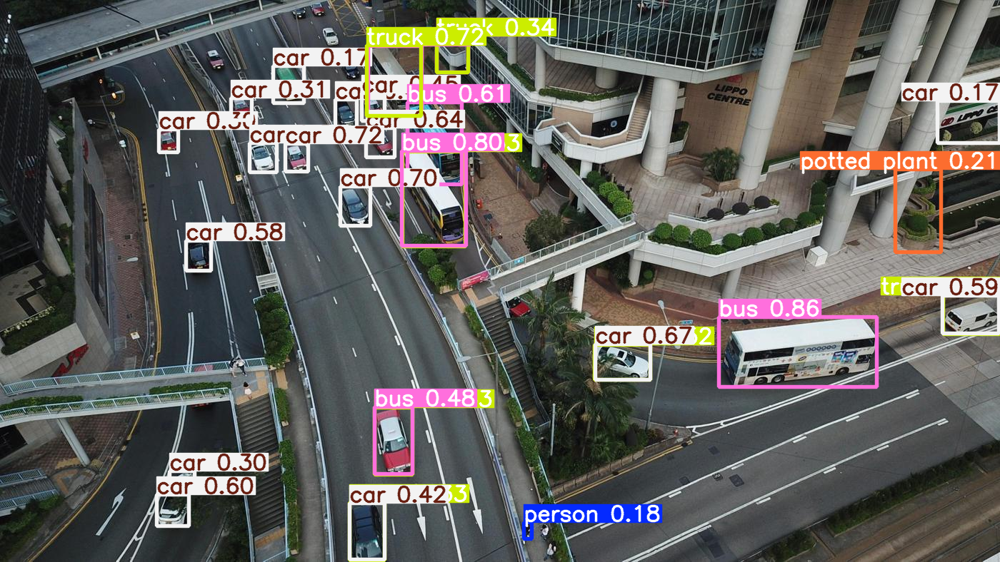

In [33]:
# Verify the files in the test image directory
test_image_dir = './images/test'
test_images = [f for f in os.listdir(test_image_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Select a random image from the test directory
sample_image_file = random.choice(test_images)
sample_image_path = os.path.join(test_image_dir, sample_image_file)

# Verify the sample image path
if os.path.exists(sample_image_path):
    print(f"Sample image path {sample_image_path} exists.")
else:
    raise FileNotFoundError(f"Sample image path {sample_image_path} does NOT exist.")

# Load YOLOv5 model for inference
device = 'cpu'  # Use 'cuda' if you want to use GPU
# Use a larger model like YOLOv5l
model = torch.hub.load('ultralytics/yolov5', 'yolov5l', pretrained=True).to(device)

# Adjust the model's confidence threshold
model.conf = 0.15  


    
# Perform inference
results = model(sample_image_path)

# Display results
results.show()


image 1/1: 788x1400 17 cars, 1 traffic light
Speed: 10.8ms pre-process, 109.6ms inference, 0.3ms NMS per image at shape (1, 3, 384, 640)


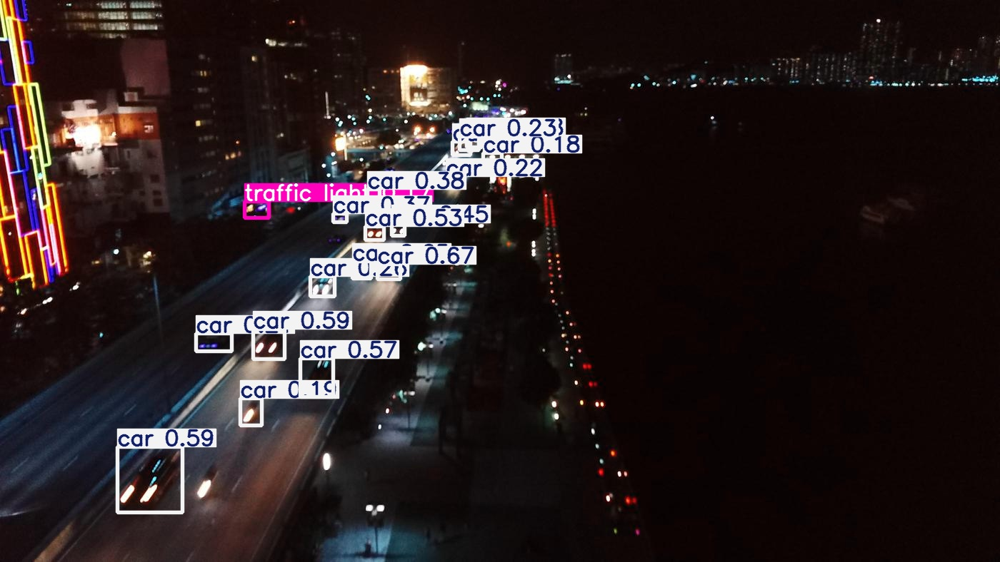

image 1/1: 1050x1400 10 persons, 27 cars, 2 motorcycles, 7 trucks, 1 traffic light, 1 tv
Speed: 7.2ms pre-process, 100.4ms inference, 0.5ms NMS per image at shape (1, 3, 480, 640)


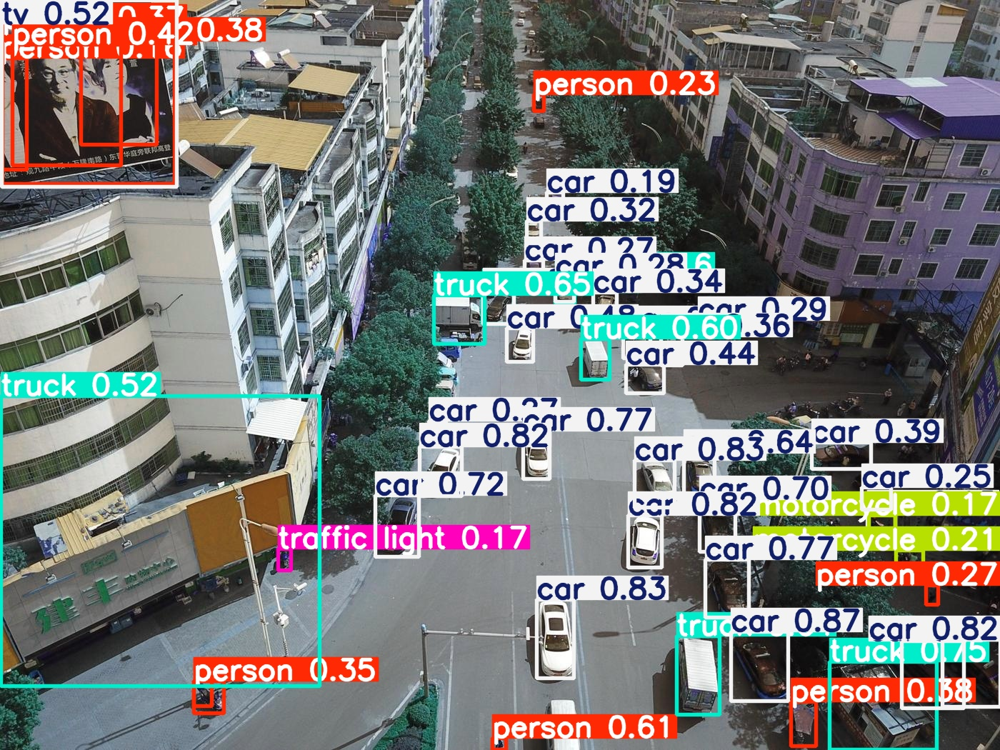

image 1/1: 1050x1400 16 persons, 14 cars, 1 truck, 5 cell phones
Speed: 7.2ms pre-process, 98.9ms inference, 0.6ms NMS per image at shape (1, 3, 480, 640)


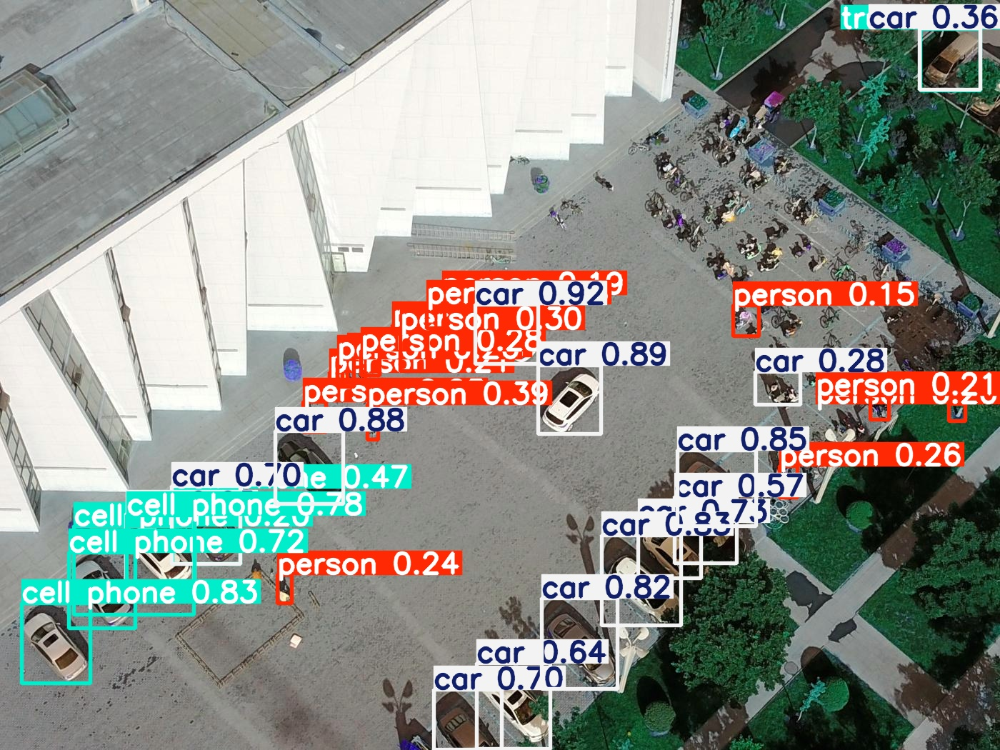

In [61]:
# Function to detect objects in an image using YOLOv5
def detect_objects(model, image_path, output_path):
    # Perform inference
    results = model(image_path)

    # Print results for debugging
    results.print()

    # Render results and save the image with bounding boxes and labels
    results.render()
    img = results.ims[0]  # Get the rendered image
    save_path = os.path.join(output_path, os.path.basename(image_path))
    cv2.imwrite(save_path, img)  # Save the image using OpenCV

    return save_path

# Detect objects in random images from the test set and display them
num_random_images = 3

random_images = random.sample(test_images, num_random_images)
output_dir = '/tmp/yolov5_results'
os.makedirs(output_dir, exist_ok=True)

for img_file in random_images:
    img_path = os.path.join(test_image_dir, img_file)
    detected_img_path = detect_objects(model, img_path, output_dir)

    # Display the image with detections
    display(IPImage(filename=detected_img_path))